In [64]:
# Numerical stuff
import numpy as np
from skimage import measure
# from scipy import misc
# import scipy.signal as scis

# Viz or image stuff
import skimage.io
import matplotlib.pyplot as plt
# from matplotlib import cm as cmap
from matplotlib.ticker import FormatStrFormatter
# import cv2

# Astronomy stuff
# from astropy.io import fits
# from properimage import single_image
# from properimage.tests import simtools
# from properimage import plot
# from astropy.modeling.functional_models import Gaussian2D
from astropy.visualization import LinearStretch, LogStretch, ZScaleInterval, MinMaxInterval, ImageNormalize
import sep

(-0.5, 5495.5, 3671.5, -0.5)

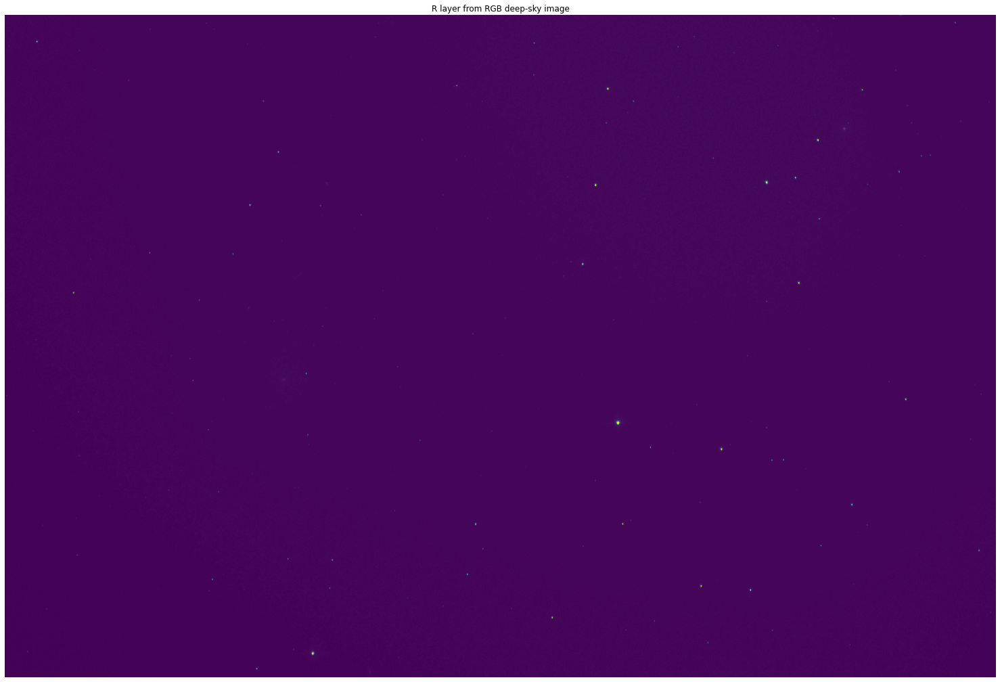

In [69]:
# img_path = './data/data3.jpg'
# image = skimage.io.imread(img_path)
# image = image[:,:,1].astype(np.float32)

img_path = "./data/NGC_5477_Light_Luminance_60_secs_2021-03-30T22-13-04_001.jpg"
image = skimage.io.imread(img_path)
image = image[:,:].astype(np.float32)

# Now show
fig, ax = plt.subplots(figsize=(32,18))
ax.set_title("R layer from RGB deep-sky image")
ax.imshow(image/image.max())
ax.axis('off')

In [100]:
def get_params_from_data(xvec, weighting=None):
    
    if weighting is None:
        weighting = np.ones((2,xvec.shape[1]))
    
    #Estimate mu
    mu_est = np.dot(xvec, weighting).reshape(2,1)

    #Estimate Sigma
    xvec_cent = xvec-mu_est
    sigma_est = np.dot(weighting*xvec_cent, xvec_cent.T)

    # longest and shortest semi axis
    e,v = np.linalg.eig(sigma_est)
    #e = np.abs(e)
    idx = e.argsort() #sort values from lowest to highest
    f=1/np.sqrt(e)
    a=f[idx[0]]
    b=f[idx[1]]
    
    # Now compute metrics
    metrics = {}
    #g2d = Gaussian2D(amplitude=1, x_mean=mu_est[0], y_mean=mu_est[0], cov_matrix=sigma_est)
    metrics["fwhms"] = (2*np.sqrt(2*np.log(2))*np.sqrt(e)).tolist()
    metrics["ellipticity"] = (a-b)/a
    metrics["angle_degree"] = np.degrees(np.arctan2(v[1,idx[1]],v[0,idx[1]]))

    
    return mu_est,sigma_est,e,v,a,b, metrics

def estimate_from_guiding(guiding_data, debug=False):
    mu_est,sigma_est,e,v,a,b,metrics = get_params_from_data(xvec)

# Use moment estimate method to find ellipticity and fwhm
def estimate_from_patch(patch, debug=False, ax=None):
    # gen 2 by N matrix with 2d point coordinates. 0,0 is
    # the top left corner of top left pixel
    Y,X=np.meshgrid(0.5+np.linspace(0,patch.shape[1]-1,patch.shape[1]),
                    0.5+np.linspace(0,patch.shape[0]-1,patch.shape[0]))
    xvec = np.array([np.reshape(X,X.size),np.reshape(Y,Y.size)])
    
    patch = patch-patch.min()
    patch = np.clip(patch, 0.2*patch.max(), a_max=None)
    weighting = patch.flatten()-patch.min()
    weighting = weighting/weighting.sum()

    mu_est,sigma_est,e,v,a,b,metrics = get_params_from_data(xvec, weighting)

    if debug:
        #Generate predefined meshgrid
        x = np.linspace(0, patch.shape[0], 100)
        y = np.linspace(0, patch.shape[1], 100)
        Yax, Xax = np.meshgrid(y, x)
        xvec = np.array([np.reshape(Xax,Xax.size),np.reshape(Yax,Yax.size)])

        #plot contour of 2-dimensional gaussian pdf
        # WARN: matplotlib show pixel 0 center at 0,0, not 0.5,0.5 as in out case
        #TODO TN replace by product of e's
        #coef = 1/np.sqrt(np.power(2*np.pi,2)*np.linalg.det(sigma_est))
        coef = 1/np.sqrt(np.power(2*np.pi,2)*np.prod(e))
        test=np.dot(np.linalg.inv(sigma_est), xvec-mu_est)
        gauss_est = coef * np.exp(-0.5* np.sum(test*(xvec-mu_est),0))
        Xax = Xax-0.5
        Yax = Yax-0.5

        if ax is None:
            fig, ax = plt.subplots(1,figsize=(8,8))
        ax.set_title("2D gaussian kernel estimation")
        heatmap = ax.imshow(patch, cmap='jet')
        plt.colorbar(heatmap, format=FormatStrFormatter('%.2e'), shrink=0.82)
        ax.contour(Yax,Xax,np.reshape(gauss_est, Xax.shape))
        ax.plot(mu_est[1]-0.5, mu_est[0]-0.5, 'r+')
        ax.axis('equal')
        
    return mu_est, sigma_est, metrics
#mu_est, sigma_est, metrics = compute_metrics(patch, debug=True)
#print(mu_est, sigma_est, metrics)

Global average background level 3.9996814727783203
Global average RMS of background


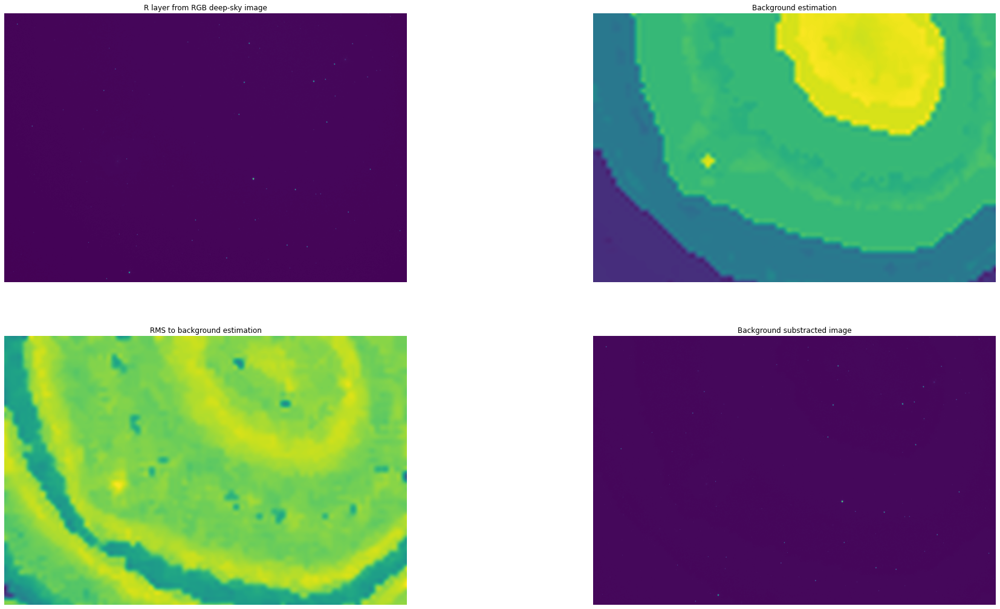

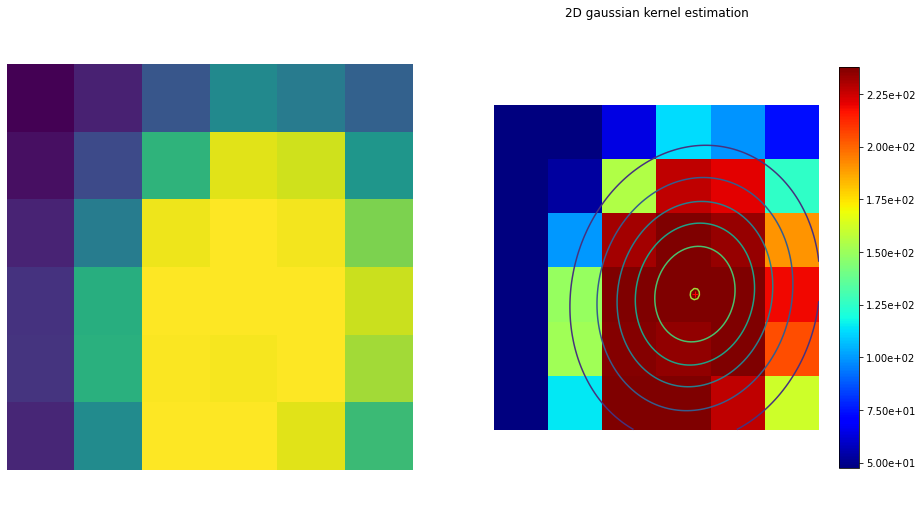

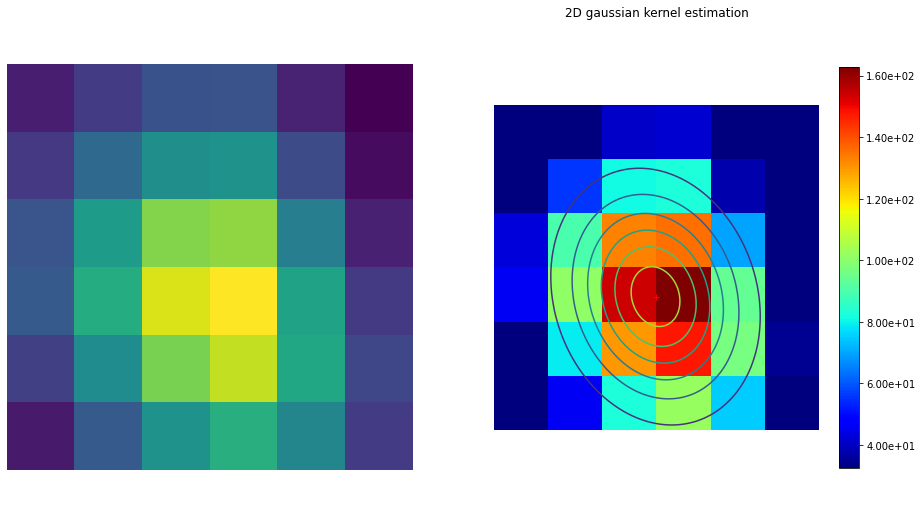

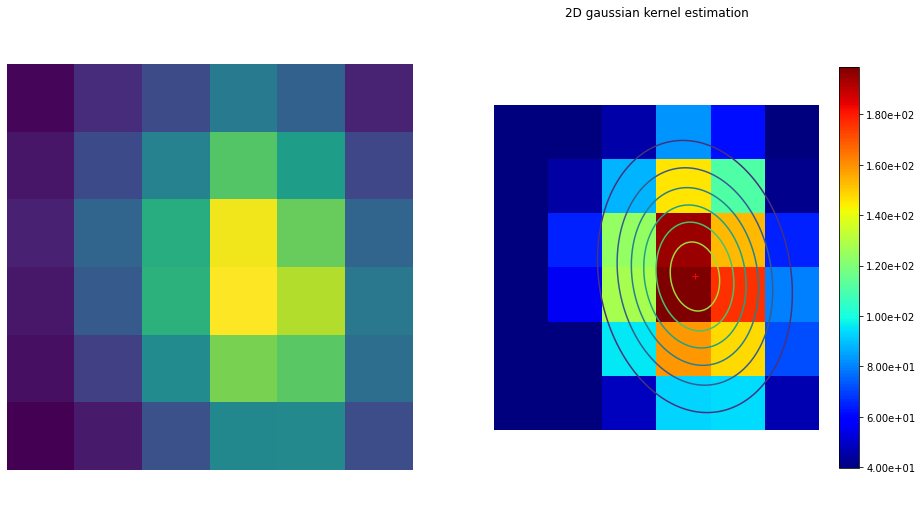

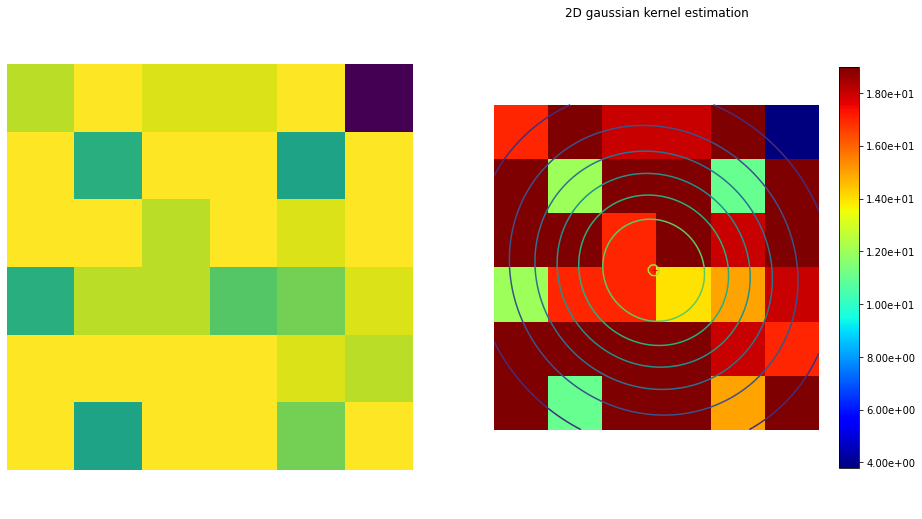

...

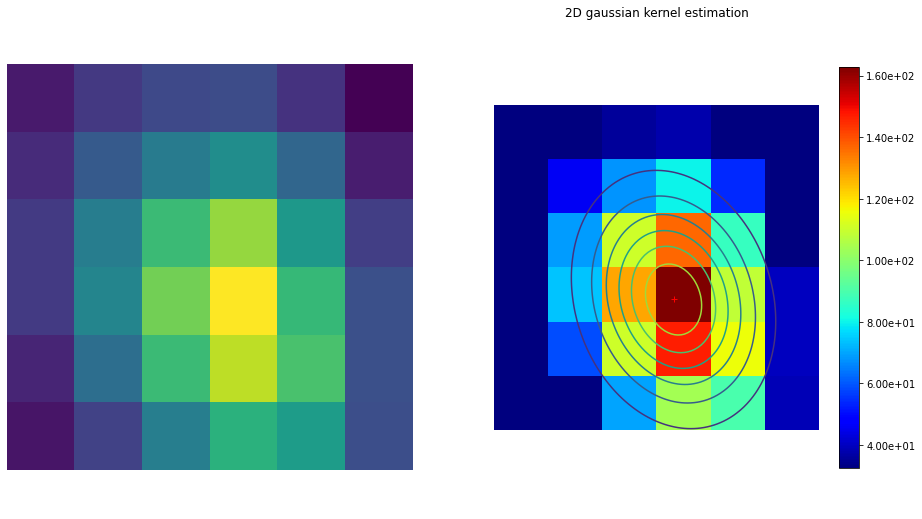

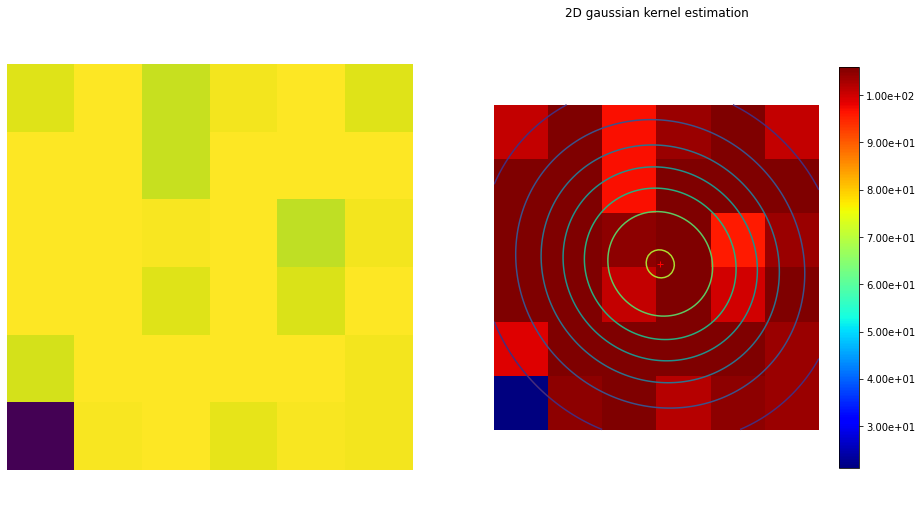

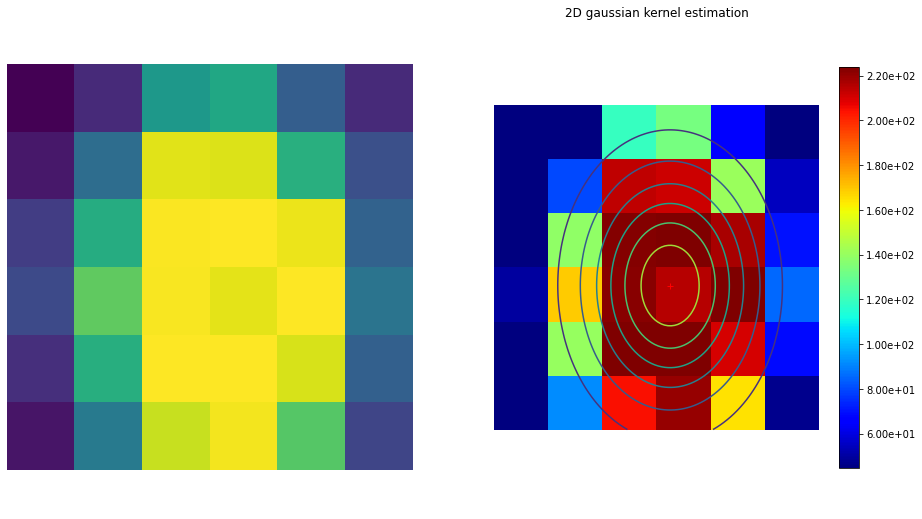

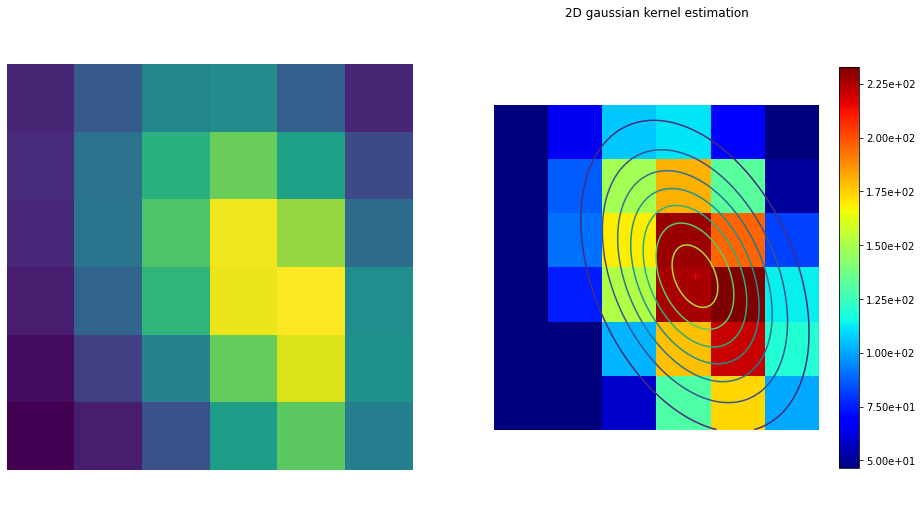

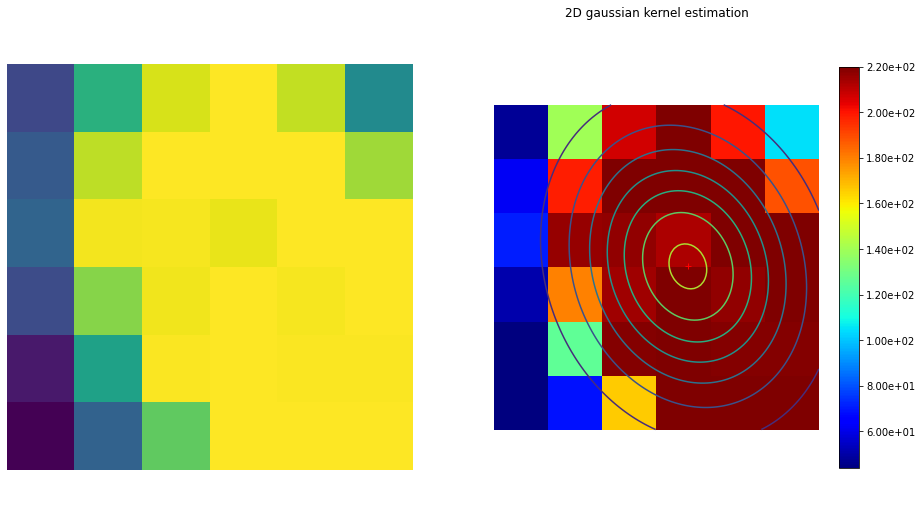

In [105]:
# Trying to achieve the patch extraction directly with sep
# Measure a spatially variable background of some image data
# (a numpy array)
bkg = sep.Background(image)
# ... or with some optional parameters
bkg = sep.Background(image, bw=64, bh=64, fw=3, fh=3)#bw=64, bh=64, fw=3, fh=3
# Evaluate the spatially variable background:
back = bkg.back()  # creates an array, same shape and type as data
# Evaluate the spatially variable RMS of the background:
rms = bkg.rms()  # creates an array, same shape and type as data
# Directly subtract the background from the data in place
print("Global average background level {}".format(bkg.globalback))
print("Global average RMS of background".format(bkg.globalrms))

# Now show
fig, ax = plt.subplots(2,2,figsize=(32,18))
ax[0,0].set_title("R layer from RGB deep-sky image")
ax[0,0].imshow(image/image.max())
ax[0,0].axis('off')

ax[0,1].set_title("Background estimation")
ax[0,1].imshow(back)
ax[0,1].axis('off')

ax[1,0].set_title("RMS to background estimation")
ax[1,0].imshow(rms)
ax[1,0].axis('off')

ax[1,1].set_title("Background substracted image")
ax[1,1].imshow(image-back)
ax[1,1].axis('off')

def get_AABB(a, b, c, angle):
    #Compute AABB - X
    maxT1=np.arctan(-(b/a)*np.tan(angle))
    maxT2=maxT1+np.pi
    val1=a*np.cos(angle)*np.cos(maxT1)-b*np.sin(angle)*np.sin(maxT1)
    val2=a*np.cos(angle)*np.cos(maxT2)-b*np.sin(angle)*np.sin(maxT2)
    minX = np.minimum(val1,val2)+c[0]
    maxX = np.maximum(val1,val2)+c[0]
    #Compute AABB - Y
    maxT1=np.arctan(b/(a*np.tan(angle)))
    maxT2=maxT1+np.pi
    val1=a*np.sin(angle)*np.cos(maxT1)+b*np.cos(angle)*np.sin(maxT1)
    val2=a*np.sin(angle)*np.cos(maxT2)+b*np.cos(angle)*np.sin(maxT2)
    minY = np.minimum(val1,val2)+c[1]
    maxY = np.maximum(val1,val2)+c[1]
    # return
    return minX, maxX, minY, maxY

def get_patch(el, data):
    """
        3 xmin
        4 xmax
        5 ymin
        6 ymax
        7 barycenter for x axis
        8 barycenter for y axis
        9 second order moment on x random variable
        10 second order moment on y random variable
        11 second order moment on xy random variable
        15 A: semi major axis of ellipse
        16 B: semi minor axis of ellipse
        17 Theta: angle from first axis growing towards second axis
        25 convolved x peak
        26 convolved y peak
        27 x peak
        28 y peak
    """
    center = np.array([el[7],el[8]])
    # First very basic method
    hs = 2.5
    miny, maxy, minx, maxx = center[0]-hs, center[0]+hs, center[1]-hs, center[1]+hs
    # second solution with ellipse AABB
    #miny, maxy, minx, maxx = get_AABB(el[15]*hs, el[16]*hs, center, el[17])
    # Build in solution
    #miny, maxy, minx, maxx = el[3], el[4], el[5], el[6]
    
    #Sanitizing
    minx=int(np.floor(max(0,minx)))
    maxx=int(np.ceil(min(data.shape[0]-1,maxx)))
    miny=int(np.floor(max(0,miny)))
    maxy=int(np.ceil(min(data.shape[1]-1,maxy)))
    
    # return
    return data[minx:maxx,miny:maxy]

# Now extract stuff
thresh = 256 * bkg.globalrms
objects, segmentation = sep.extract(image, thresh, segmentation_map=True)

# Show extracted patches
i = 0
for el in objects:
    patch = get_patch(el, image)
    fig, ax = plt.subplots(1,2,figsize=(16,9))
    ax[0].imshow(patch)
    estimate_from_patch(patch, debug=True, ax=ax[1])
    [x.axis('off') for x in ax]
    print("===================")
    i= i+1
    if i==10:
        break


In [102]:
# Now do the thing
def build_metric_maps(image):
    #Pre process image
    bkg = sep.Background(image)
    back = bkg.back()
    rms = bkg.rms()
    
    #Extract infos
    thresh = 16 * bkg.globalrms
    objects, segmentation = sep.extract(image, thresh, segmentation_map=True)

    # sample images patches
    samples = {'coord_x':[], 'coord_y':[], 'fwhms':[], 'ellipticity':[], 'angle_degree':[]}
    for el in objects:
        with np.errstate(divide='raise'):
            try:
                patch = get_patch(el, image)
                mu_est, _, metrics = estimate_from_patch(patch, debug=False)
                samples['coord_x'].append(el[3]+mu_est[0])
                samples['coord_y'].append(el[5]+mu_est[1])
                for metric_key in ['fwhms', 'ellipticity', 'angle_degree']:
                    samples[metric_key].append(metrics[metric_key])
            except FloatingPointError:
                pass
        
    # Perform regression
    from sklearn.preprocessing import PolynomialFeatures
    from sklearn.linear_model import LinearRegression
    from sklearn.pipeline import Pipeline
    models = {}
    for metric_key in ['fwhms', 'ellipticity', 'angle_degree']:
        model = Pipeline([('poly', PolynomialFeatures(degree=3)),
                          ('linear', LinearRegression(fit_intercept=True))])
        # fit to an order-3 polynomial data
        features = np.array([samples['coord_x'], samples['coord_y']]).squeeze().T
        print(features.shape)
        labels = np.array(samples[metric_key]).reshape(-1, 1)
        print(labels.shape)
        models[metric_key] = model.fit(features, labels)
        
    # Provide overview
    res = 16
    y_lowres, x_lowres = np.meshgrid(np.arange(0, image.shape[0], image.shape[0]/res),
                                     np.arange(0, image.shape[1], image.shape[1]/res))
    maps = {}
    for metric_key in ['fwhms', 'ellipticity', 'angle_degree']:
        maps[metric_key] = np.zeros_like(x_lowres, dtype=np.float32)
    for x_idx in range(x_lowres.shape[0]):
        for y_idx in range(y_lowres.shape[1]):
            x = x_lowres[x_idx, y_idx]
            y = y_lowres[x_idx, y_idx]
            for metric_key in ['fwhms', 'ellipticity', 'angle_degree']:
                val = models[metric_key].predict(np.array([x,y]).reshape(-1,1).T)
                maps[metric_key][x_idx, y_idx] = val
    return maps

maps = build_metric_maps(image)
for key, val in maps.items():
    fig, ax = plt.subplots(1, figsize=(12,12))
    ax.set_title("{} map".format(str(key).replace("_", " ")))
    heatmap = ax.imshow(val, cmap='jet')
    plt.colorbar(heatmap, shrink=0.82)
    ax.axis('off')

(311, 2)
(622, 1)


ValueError: Found input variables with inconsistent numbers of samples: [311, 622]

In [ ]:
def gen_gaussian_patch(size=21, fwhm=[3, 1], theta=3.*np.pi/4., debug=False):
    """
        fwhm = 2*np.sqrt(2*np.log(2))*sigma
    """
    #define mesh
    Y,X=np.meshgrid(0.5+np.linspace(0,size-1,size),0.5+np.linspace(0,size-1,size))
    xvec = np.array([np.reshape(X,X.size),np.reshape(Y,Y.size)])
    
    #define a 2D rotation matrix:
    def GetRotMat(theta):
      return np.array([[np.cos(theta),-np.sin(theta)],
        [np.sin(theta),np.cos(theta)]])
    Mrot = GetRotMat(theta)
    #define anisotropic and rotated gaussian
    Sigma = np.dot(Mrot,np.dot(np.diag(fwhm/np.sqrt(8*np.log(2)))**2,Mrot.T))
    #mu = np.array([[size/2],[size/2]])
    mu = np.array([[size/3],[2*size/3]])
    coef = 1/np.sqrt(np.power(2*np.pi,2)*np.linalg.det(Sigma))
    
    #2-dimensional gaussian pdf
    test=np.dot(np.linalg.inv(Sigma),xvec-mu)
    K=coef * np.exp(-0.5* np.sum(test*(xvec-mu),0))
    K=np.reshape(K,X.shape)/K.sum()
    
    #Normalize
    K/=K.sum()
    KT=K[::-1,::-1]
    
    #Plot
    if debug:
        fig, ax = plt.subplots(1,figsize=(8,8))
        ax.set_title("2D gaussian kernel")
        heatmap = ax.imshow(K, cmap='jet')
        plt.colorbar(heatmap, format=FormatStrFormatter('%.2e'), shrink=0.82)
        ax.plot(mu[1]-0.5, mu[0]-0.5, 'r+') # Stuff need to be inverted for plotting...
        center_value = K[int(mu[0]),int(mu[1])]
        right_value = K[int(mu[0]+np.cos(theta)*fwhm[0]/2),
                        int(mu[1]+np.sin(theta)*fwhm[0]/2)]
        left_value = K[int(mu[0]+np.cos(theta+np.pi/2)*fwhm[1]/2),
                       int(mu[1]+np.sin(theta+np.pi/2)*fwhm[1]/2)]
        print("Value close to maximum is {}".format(center_value))
        print("Ratio close to fwhm is {}".format(right_value/center_value))
        print("Ratio close to fwhm is {}".format(left_value/center_value))
    return K

patch = gen_gaussian_patch(size=21, fwhm=[7, 3], theta=3*np.pi/4, debug=True)


In [ ]:
"""
  Perform Richardson-Lucy algorithm
"""
nbiter = 25
xk=blurred.copy()
for i in range(nbiter):
    estim = scis.convolve2d(xk, K,
      mode='same', boundary='symm', fillvalue=0)
    corr = scis.convolve2d(blurred/estim, KT,
      mode='same', boundary='symm', fillvalue=0)
    xk*=corr

#Evaluate quality
psnrXk = measure.compare_psnr(xk, blurred, dynamic_range=dyn)
ssimXk = measure.compare_ssim(xk, blurred, win_size=5, dynamic_range=dyn)

#Plot
plt.figure(3)
plt.title("Reconstructed image, PSNR= "+("%.2f" % psnrXk)+
  " SSIM= "+("%.2f" % ssimXk))
plt.imshow(xk, interpolation="nearest", cmap=plt.cm.gray)
plt.axis("off")


#Show everything
plt.show()

(-0.5, 799.5, 532.5, -0.5)

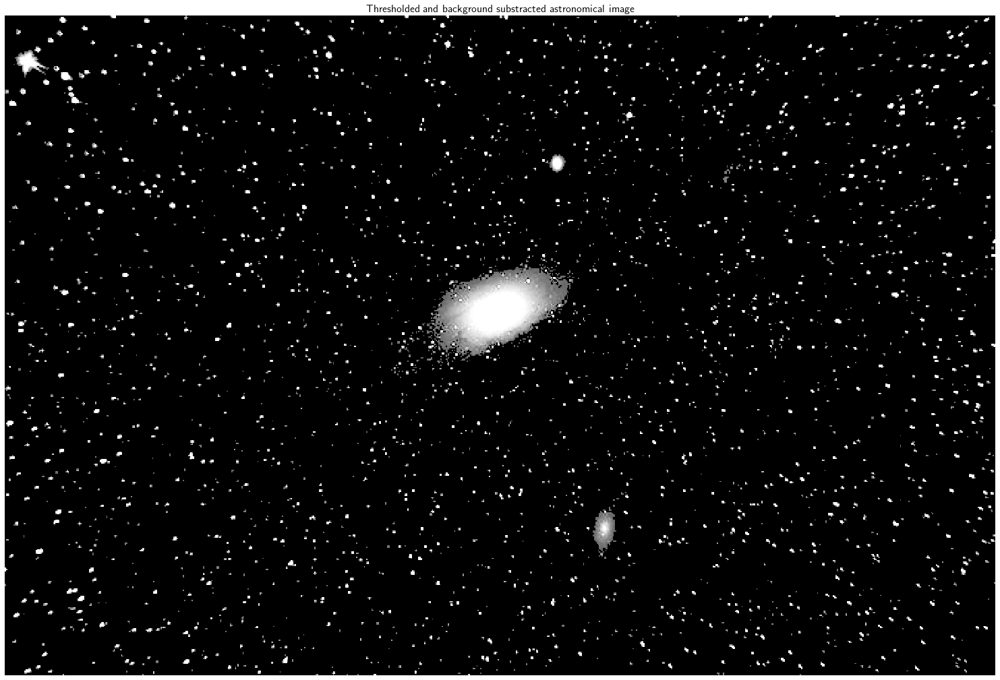

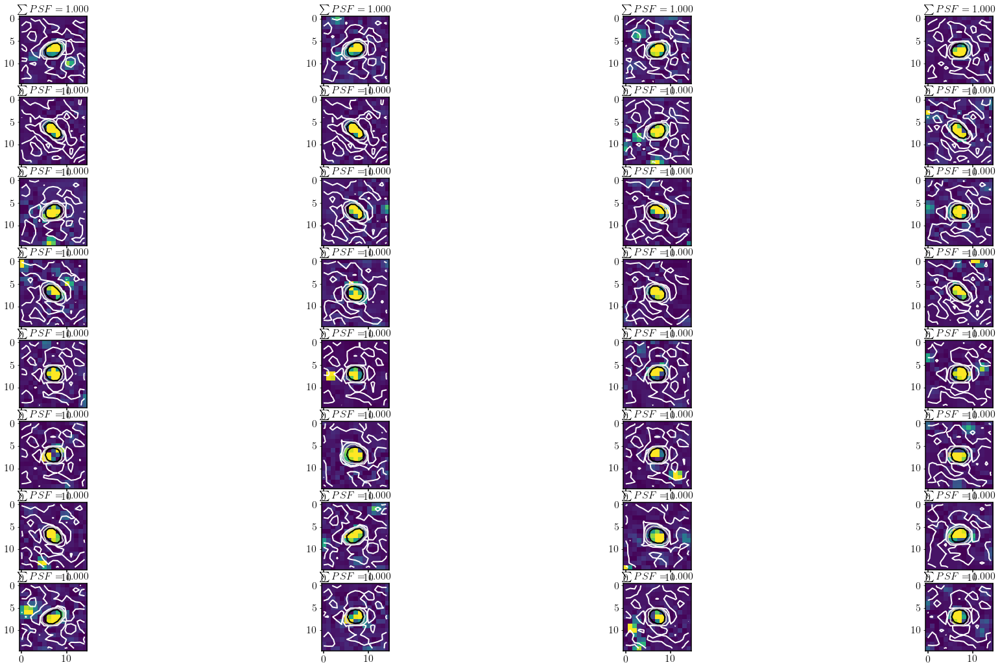

In [105]:
nb=32
fig, axs = plt.subplots((nb+3)//4,4,figsize=(32, 18))
for i in range(nb):
    nsrc = np.random.randint(0, sim.n_sources)
    xc, yc = sim.best_sources[nsrc][['y', 'x']]
    try:
        patch = single_image.extract_array(sim.bkg_sub_img, sim.stamp_shape,
                                 [xc, yc], fill_value=sim._bkg.globalrms, mode='strict')
    except:
        nsrc = np.random.randint(0, sim.n_sources)
        xc, yc = sim.best_sources[nsrc][['y', 'x']]
        patch = single_image.extract_array(sim.bkg_sub_img, sim.stamp_shape,
                                 [xc, yc], fill_value=sim._bkg.globalrms, mode='strict')

    #patch = np.log10(patch)
    ax = axs[i//4,i%4]
    ax.imshow(patch, vmin=np.percentile(patch, q=10), vmax=np.percentile(patch, q=98))
    ax.tick_params(labelsize=16)
    try:
        thepsf = sim.get_psf_xy(xc, yc)
    except ValueError:
        print(xc, yc)
    #print(patch.shape, thepsf.shape)
    labels = {'sum': np.sum(thepsf)}
    ax.set_title(r'$\sum PSF = {sum:4.3f}$'.format(**labels))
    ax.contour(thepsf, levels=[0.0015, 0.003, 0.01, 0.03], cmap='Greys')

Global average background level 23.825103759765625
Global average RMS of background


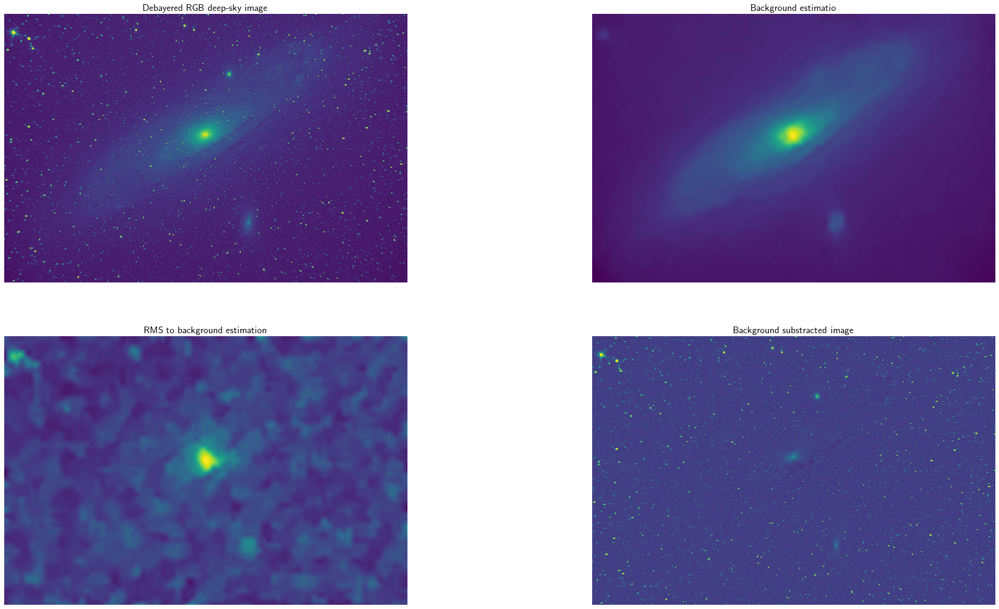

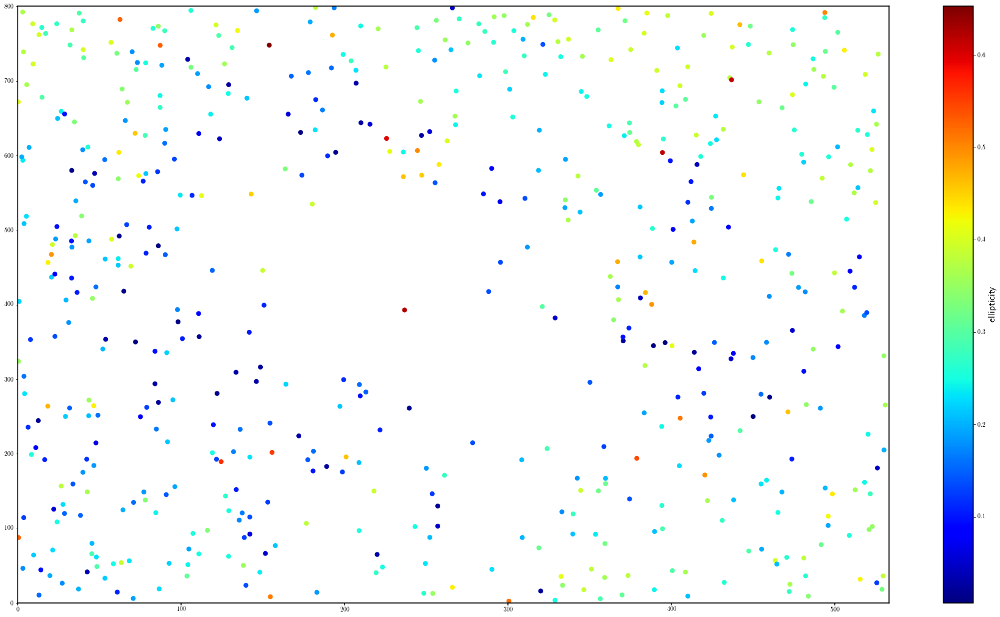

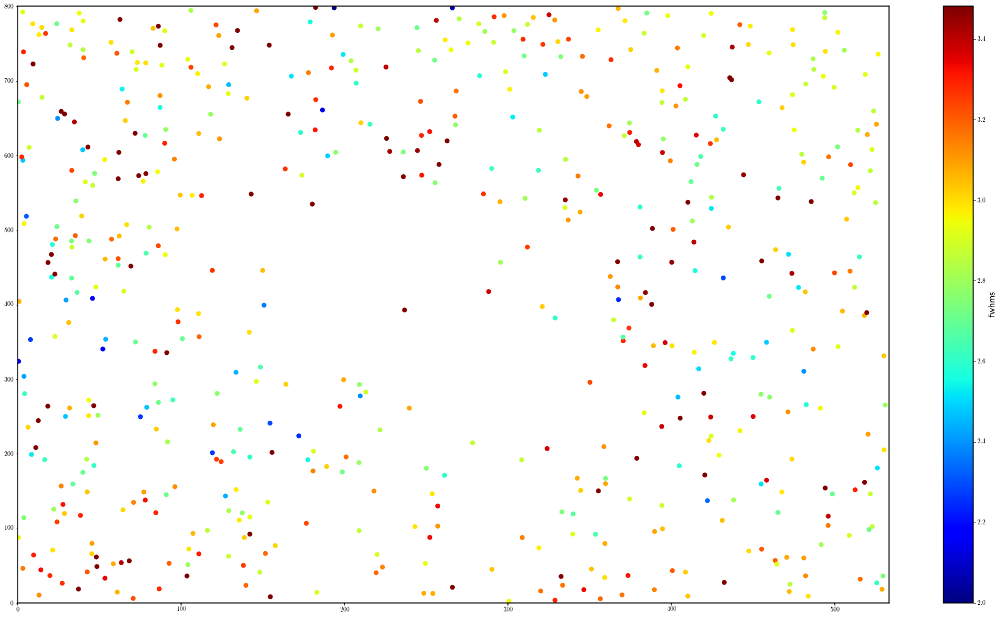

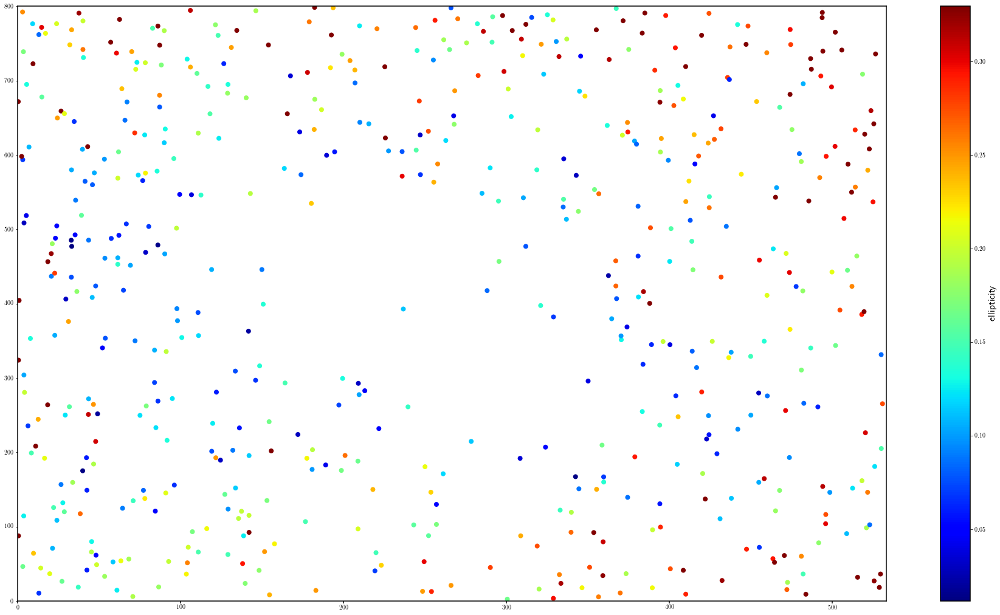

In [188]:
# Trying to achieve the patch extraction directly with sep
# Measure a spatially variable background of some image data
# (a numpy array)
bkg = sep.Background(image)
# ... or with some optional parameters
bkg = sep.Background(image, bw=10, bh=10, fw=3, fh=3)#bw=64, bh=64, fw=3, fh=3
# Evaluate the spatially variable background:
back = bkg.back()  # creates an array, same shape and type as data
# Evaluate the spatially variable RMS of the background:
rms = bkg.rms()  # creates an array, same shape and type as data
# Directly subtract the background from the data in place
print("Global average background level {}".format(bkg.globalback))
print("Global average RMS of background".format(bkg.globalrms))

# Now show
fig, ax = plt.subplots(2,2,figsize=(32,18))
ax[0,0].set_title("Debayered RGB deep-sky image")
ax[0,0].imshow(image/image.max())
ax[0,0].axis('off')

ax[0,1].set_title("Background estimatio")
ax[0,1].imshow(back)
ax[0,1].axis('off')

ax[1,0].set_title("RMS to background estimation")
ax[1,0].imshow(rms)
ax[1,0].axis('off')

ax[1,1].set_title("Background substracted image")
ax[1,1].imshow(image-back)
ax[1,1].axis('off')

def get_AABB(a, b, c, angle):
    #Compute AABB - X
    maxT1=np.arctan(-(b/a)*np.tan(angle))
    maxT2=maxT1+np.pi
    val1=a*np.cos(angle)*np.cos(maxT1)-b*np.sin(angle)*np.sin(maxT1)
    val2=a*np.cos(angle)*np.cos(maxT2)-b*np.sin(angle)*np.sin(maxT2)
    minX = np.minimum(val1,val2)+c[0]
    maxX = np.maximum(val1,val2)+c[0]
    #Compute AABB - Y
    maxT1=np.arctan(b/(a*np.tan(angle)))
    maxT2=maxT1+np.pi
    val1=a*np.sin(angle)*np.cos(maxT1)+b*np.cos(angle)*np.sin(maxT1)
    val2=a*np.sin(angle)*np.cos(maxT2)+b*np.cos(angle)*np.sin(maxT2)
    minY = np.minimum(val1,val2)+c[1]
    maxY = np.maximum(val1,val2)+c[1]
    # return
    return minX, maxX, minY, maxY

def get_patch(el, data):
    """
        3 xmin
        4 xmax
        5 ymin
        6 ymax
        7 barycenter for x axis
        8 barycenter for y axis
        9 second order moment on x random variable
        10 second order moment on y random variable
        11 second order moment on xy random variable
        15 A: semi major axis of ellipse
        16 B: semi minor axis of ellipse
        17 Theta: angle from first axis growing towards second axis
        25 convolved x peak
        26 convolved y peak
        27 x peak
        28 y peak
    """
    center = np.array([el[7],el[8]])
    # First very basic method
    hs = 2.5
    miny, maxy, minx, maxx = center[0]-hs, center[0]+hs, center[1]-hs, center[1]+hs
    # second solution with ellipse AABB
    #miny, maxy, minx, maxx = get_AABB(el[15]*hs, el[16]*hs, center, el[17])
    # Build in solution
    #miny, maxy, minx, maxx = el[3], el[4], el[5], el[6]
    
    #Sanitizing
    minx=int(np.floor(max(0,minx)))
    maxx=int(np.ceil(min(data.shape[0]-1,maxx)))
    miny=int(np.floor(max(0,miny)))
    maxy=int(np.ceil(min(data.shape[1]-1,maxy)))
    
    # return
    return data[minx:maxx,miny:maxy]

# Now extract stuff
thresh = 16 * bkg.globalrms
objects, segmentation = sep.extract(image, thresh, segmentation_map=True)
#print(objects[0])
i=0

#np.random.shuffle(objects)
metrics = []
#objects = sorted(objects, key=lambda x: x[16]/x[15])  
for el in objects:
    #fig, ax = plt.subplots(figsize=(3,3))
    #ax.imshow(image[el[5]:2*el[6]-el[5],el[3]:2*el[4]-el[3]])
    #ax.imshow(image[el[5]:el[6],el[3]:el[4]])
    patch = get_patch(el, image)
    #ax.imshow(patch)
    #ax.axis('off')
    metrics.append(compute_metrics(patch)[2])
    #print(el)
    i= i+1
    #if i==100:
    #    break
        
# Show maps
xs = [el[8] for el in objects]
ys = [el[7] for el in objects]
zs = [(el[15]-el[16])/el[15] for el in objects]
fig, ax = plt.subplots(figsize=(32,18))
fig.title = 'SEP reference ellipticity map'
scat = ax.scatter(xs, ys, c=zs, cmap=cmap.jet)
ax.axis([0, image.shape[0], 0, image.shape[1]])
cb = plt.colorbar(scat)
cb.set_label('ellipticity')

for metric in ['fwhms','ellipticity']:
    zs = [max(el[metric]) if isinstance(el[metric], Iterable) else el[metric] for el in metrics]
    fig, ax = plt.subplots(figsize=(32,18))
    fig.title = 'computer {} map'.format(metric)
    scat = ax.scatter(xs, ys, c=zs, cmap=cmap.jet, vmin=np.percentile(zs, 0.1), vmax=np.percentile(zs, 90))
    ax.axis([0, image.shape[0], 0, image.shape[1]])
    cb = plt.colorbar(scat)
    cb.set_label(metric)

(207, 207) (225, 207)
Projected psf model of size (15, 15) from the 43 first eigenvectors
Reconstructing the psf map of size (533, 800) from 43 coefficients


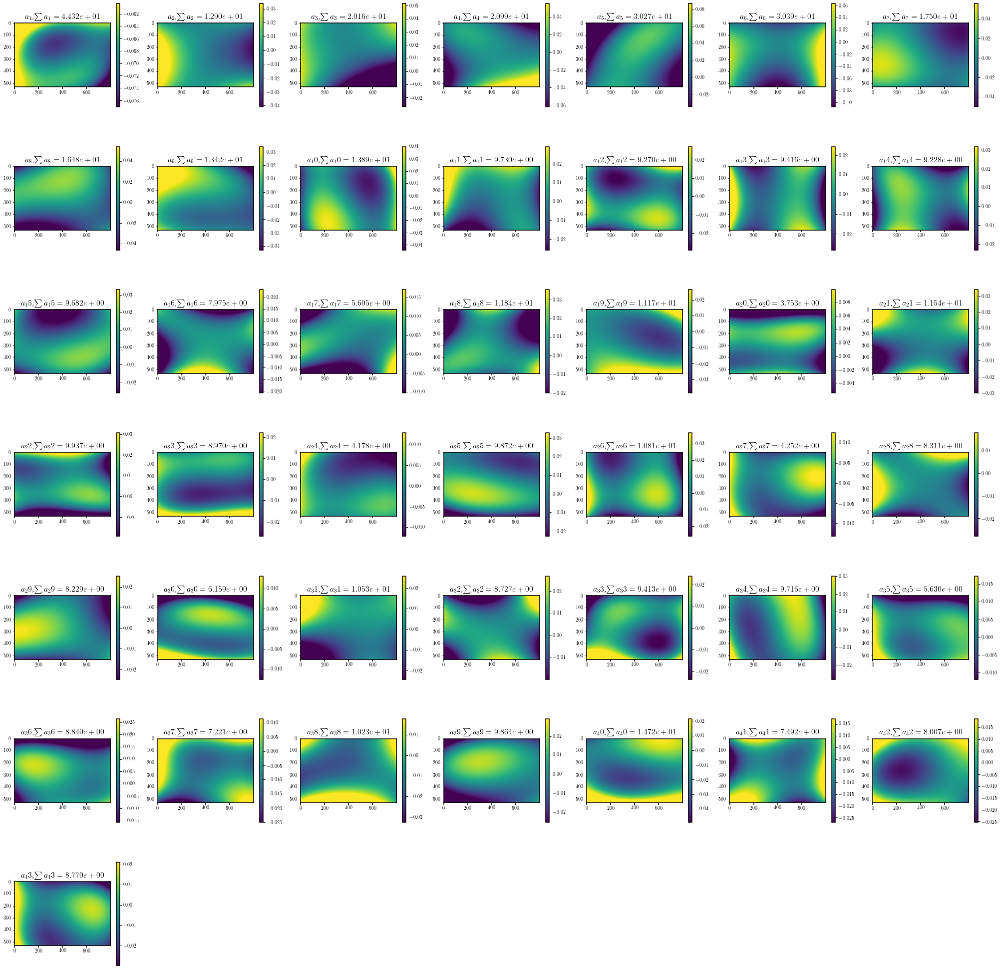

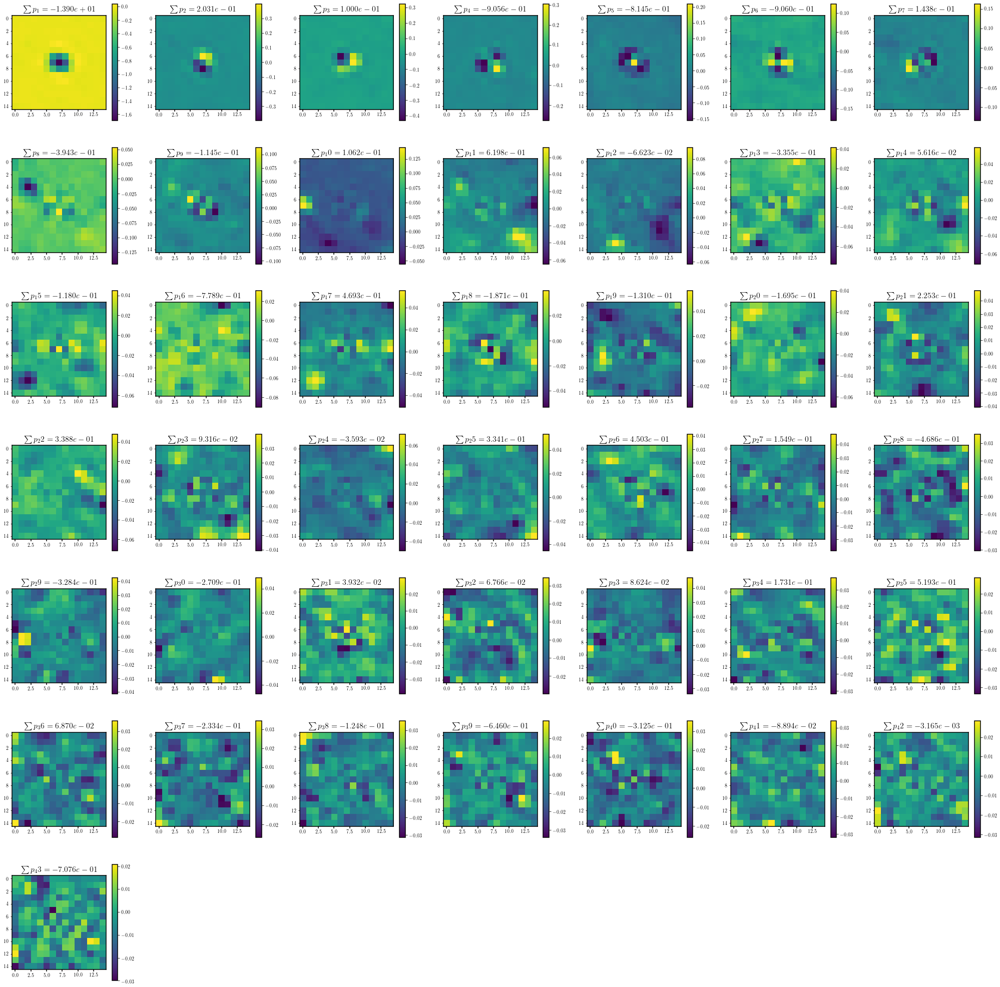

In [106]:
a_fields, psf_basis = sim.get_variable_psf(inf_loss=0.05)
x, y = sim.get_afield_domain()
print("Projected psf model of size {} from the {} first eigenvectors".format(
      psf_basis[0].shape, len(psf_basis)))
print("Reconstructing the psf map of size {} from {} coefficients".format(a_fields[0](x, y).shape, len(a_fields)))
plot.plot_afields(a_fields=a_fields, x=x, y=y, nbook=True)
plot.plot_psfbasis(psf_basis=psf_basis, nbook=True)

In [81]:
a_fields

[<Polynomial2D(3, c0_0=0.02501078, c1_0=0.00028486, c2_0=-0.00000075, c3_0=0., c0_1=0.00018079, c0_2=-0.00000029, c0_3=0., c1_1=-0.0000004, c1_2=0., c2_1=0.)>,
 <Polynomial2D(3, c0_0=-0.00532137, c1_0=-0.0003355, c2_0=0.00000047, c3_0=0., c0_1=0.00011924, c0_2=-0.00000036, c0_3=0., c1_1=0.00000113, c1_2=-0., c2_1=-0.)>,
 <Polynomial2D(3, c0_0=-0.03996323, c1_0=0.00001903, c2_0=-0.00000032, c3_0=0., c0_1=0.00021292, c0_2=-0.00000041, c0_3=0., c1_1=-0.00000027, c1_2=0., c2_1=0.)>,
 <Polynomial2D(3, c0_0=0.00814739, c1_0=-0.00013291, c2_0=0.00000184, c3_0=-0., c0_1=-0.00016148, c0_2=0.00000069, c0_3=-0., c1_1=-0.0000007, c1_2=0., c2_1=-0.)>,
 <Polynomial2D(3, c0_0=-0.25239734, c1_0=0.00107805, c2_0=-0.00000196, c3_0=0., c0_1=0.0011764, c0_2=-0.00000133, c0_3=0., c1_1=-0.0000021, c1_2=0., c2_1=0.)>,
 <Polynomial2D(3, c0_0=0.06962278, c1_0=-0.00084636, c2_0=0.00000197, c3_0=-0., c0_1=-0.00015065, c0_2=0.00000066, c0_3=-0., c1_1=0.00000128, c1_2=-0., c2_1=-0.)>,
 <Polynomial2D(3, c0_0=-0.012

Value close to maximum is 0.03609387367095224
Ratio close to fwhm is 0.5750718240486545
Ratio close to fwhm is 0.2916322598940291


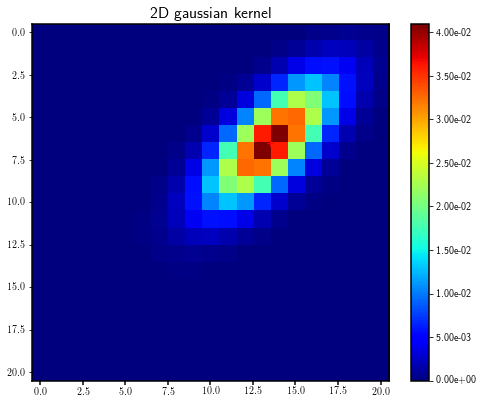

In [82]:
def gen_gaussian_patch(size=21, fwhm=[3, 1], theta=3.*np.pi/4., debug=False):
    """
        fwhm = 2*np.sqrt(2*np.log(2))*sigma
    """
    #define mesh
    Y,X=np.meshgrid(0.5+np.linspace(0,size-1,size),0.5+np.linspace(0,size-1,size))
    xvec = np.array([np.reshape(X,X.size),np.reshape(Y,Y.size)])
    
    #define a 2D rotation matrix:
    def GetRotMat(theta):
      return np.array([[np.cos(theta),-np.sin(theta)],
        [np.sin(theta),np.cos(theta)]])
    Mrot = GetRotMat(theta)
    #define anisotropic and rotated gaussian
    Sigma = np.dot(Mrot,np.dot(np.diag(fwhm/np.sqrt(8*np.log(2)))**2,Mrot.T))
    #mu = np.array([[size/2],[size/2]])
    mu = np.array([[size/3],[2*size/3]])
    coef = 1/np.sqrt(np.power(2*np.pi,2)*np.linalg.det(Sigma))
    
    #2-dimensional gaussian pdf
    test=np.dot(np.linalg.inv(Sigma),xvec-mu)
    K=coef * np.exp(-0.5* np.sum(test*(xvec-mu),0))
    K=np.reshape(K,X.shape)/K.sum()
    
    #Normalize
    K/=K.sum()
    KT=K[::-1,::-1]
    
    #Plot
    if debug:
        fig, ax = plt.subplots(1,figsize=(8,8))
        ax.set_title("2D gaussian kernel")
        heatmap = ax.imshow(K, cmap='jet')
        plt.colorbar(heatmap, format=FormatStrFormatter('%.2e'), shrink=0.82)
        ax.plot(mu[1]-0.5, mu[0]-0.5, 'r+') # Stuff need to be inverted for plotting...
        center_value = K[int(mu[0]),int(mu[1])]
        right_value = K[int(mu[0]+np.cos(theta)*fwhm[0]/2),
                        int(mu[1]+np.sin(theta)*fwhm[0]/2)]
        left_value = K[int(mu[0]+np.cos(theta+np.pi/2)*fwhm[1]/2),
                       int(mu[1]+np.sin(theta+np.pi/2)*fwhm[1]/2)]
        print("Value close to maximum is {}".format(center_value))
        print("Ratio close to fwhm is {}".format(right_value/center_value))
        print("Ratio close to fwhm is {}".format(left_value/center_value))
    return K

patch = gen_gaussian_patch(size=21, fwhm=[7, 3], theta=3*np.pi/4, debug=True)


[[7.40819717]
 [7.56331549]] [[13.48647619  0.60000539]
 [ 0.60000539 14.62179343]] {'fwhms': array([8.56460544, 9.08365986]), 'ellipticity': 0.057141551551549936, 'angle_degree': -113.29340445835743}


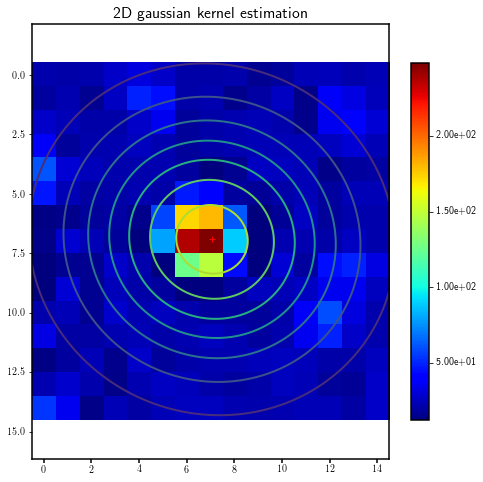

/home/gnthibault/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:45: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


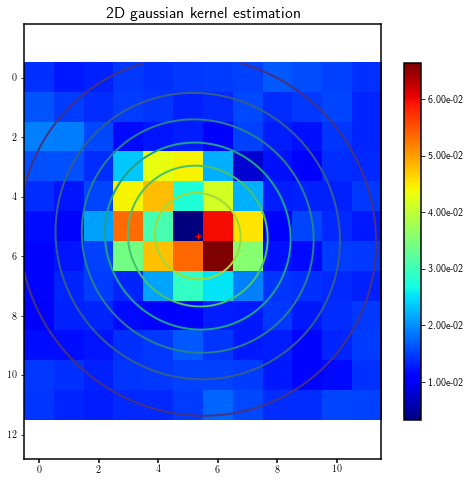

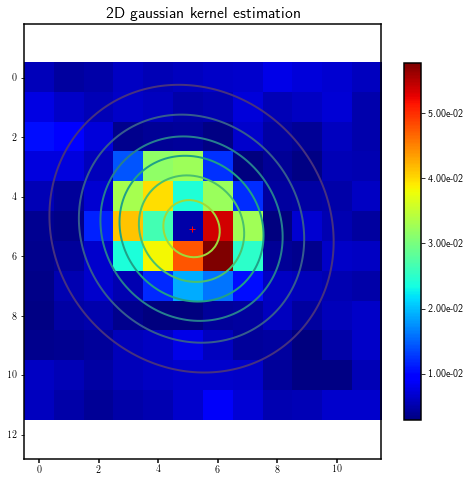

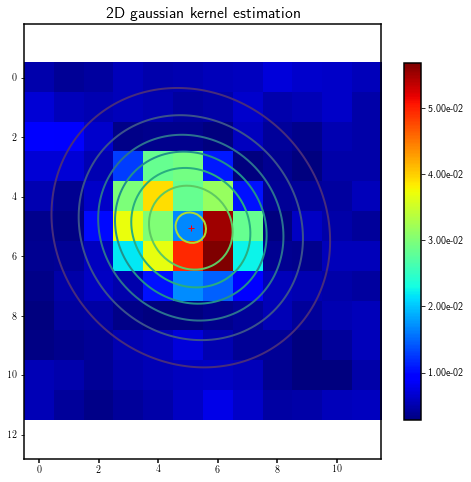

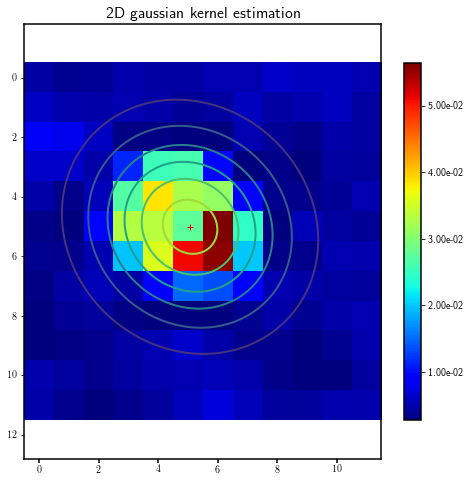

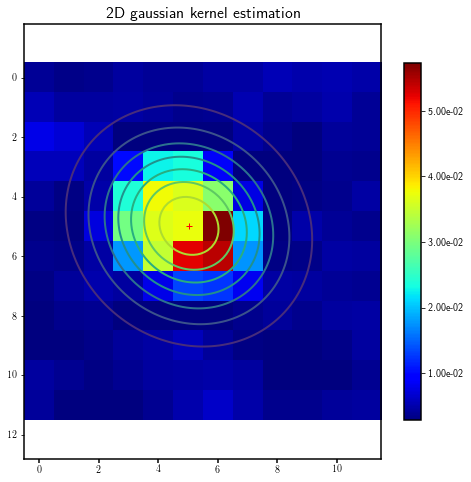

...

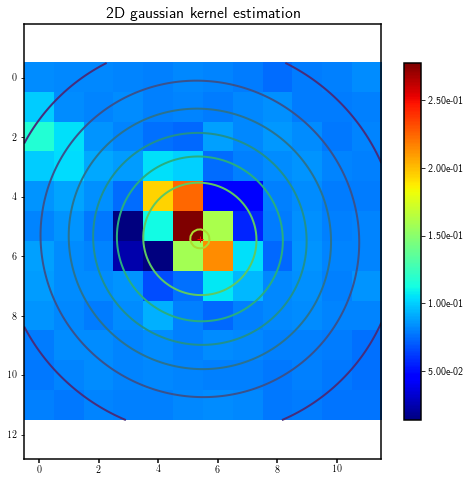

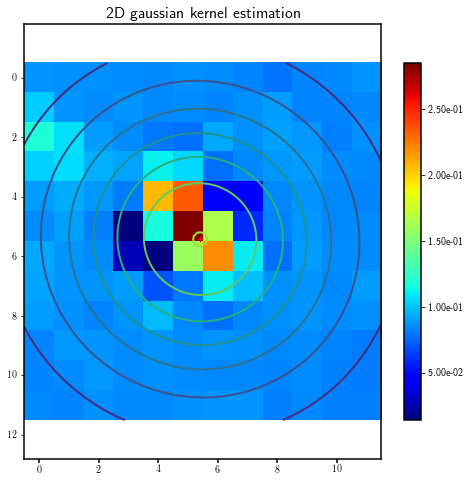

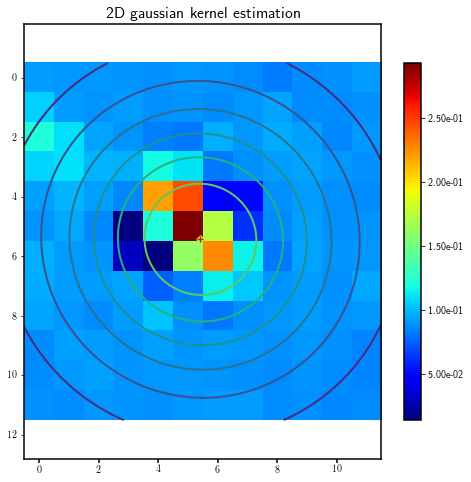

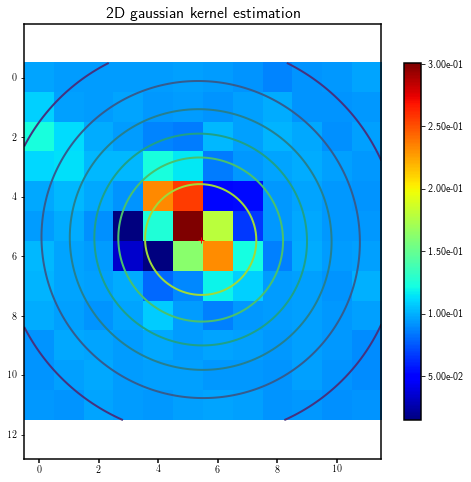

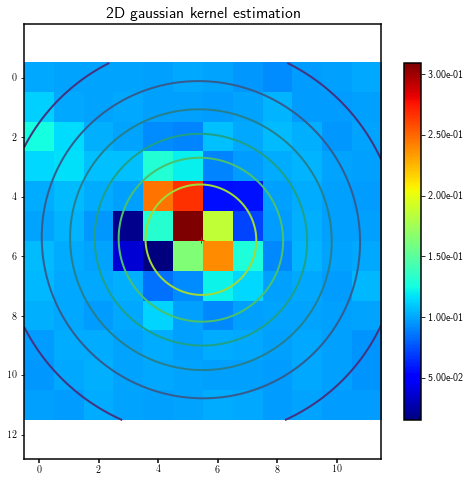

In [91]:
def build_metric_maps(image, psf_basis, a_fields, res=10, order=None):
    #print("Projected psf model of size {} from the {} first eigenvectors".format(
    #  psf_basis[0].shape, len(psf_basis)))
    #print("Reconstructing the psf map of size {} from {} coefficients".format(a_fields[0](x, y).shape, len(a_fields)))
    y_lowres, x_lowres = np.meshgrid(np.arange(0, image.shape[0], image.shape[0]/res),
                                     np.arange(0, image.shape[1], image.shape[1]/res))
    maps = {}
    for metric_key in ['fwhms', 'ellipticity', 'angle_degree']:
        maps[metric_key] = np.zeros_like(x_lowres, dtype=np.float32)
    if order is None:
        order = len(a_fields)
    else:
        order = min(order, len(a_fields))
    for x_idx in range(x_lowres.shape[0]):
        for y_idx in range(y_lowres.shape[1]):
            x = x_lowres[x_idx, y_idx]
            y = y_lowres[x_idx, y_idx]
            patch = np.zeros_like(a_fields[0], dtype=np.float64)
            for i in range(order):
                patch = patch + a_fields[i](x, y)*psf_basis[i]
            patch = patch[3:15,3:15]
            #fig, ax = plt.subplots(1, figsize=(12,12))
            #ax.imshow(patch)
            #print("x_idx {}, y_idx {}".format(x_idx,y_idx))
            mu_est, sigma_est, metrics = compute_metrics(patch, debug=True)
            #print("fwhm: {}, sigma_est {}".format(max(metrics["fwhms"]), sigma_est))
            for metric_key in ['fwhms', 'ellipticity', 'angle_degree']:
                val = metrics[metric_key]
                maps[metric_key][x_idx, y_idx] = max(val) if isinstance(val, Iterable) else val
    return maps

maps = build_metric_maps(image, psf_basis, a_fields, res=20, order=10)

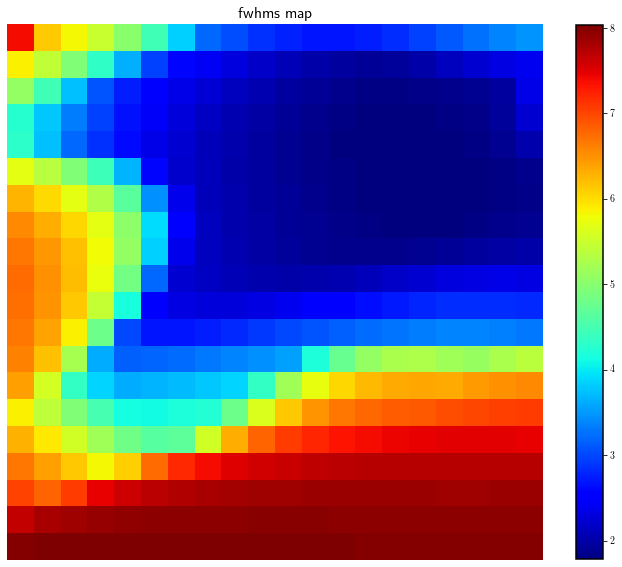

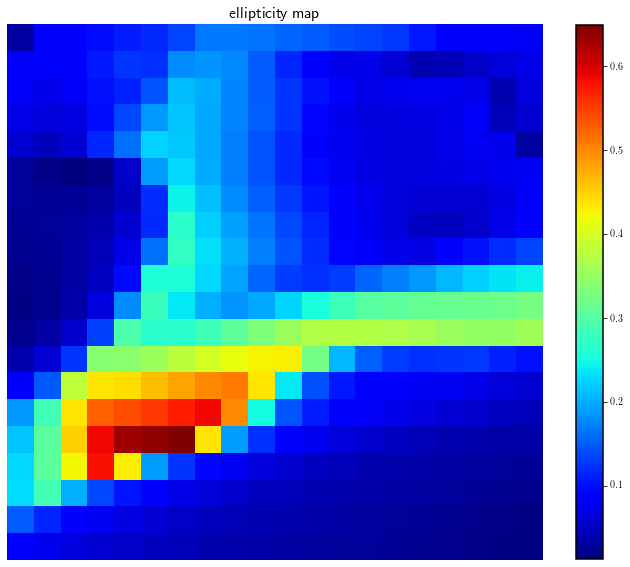

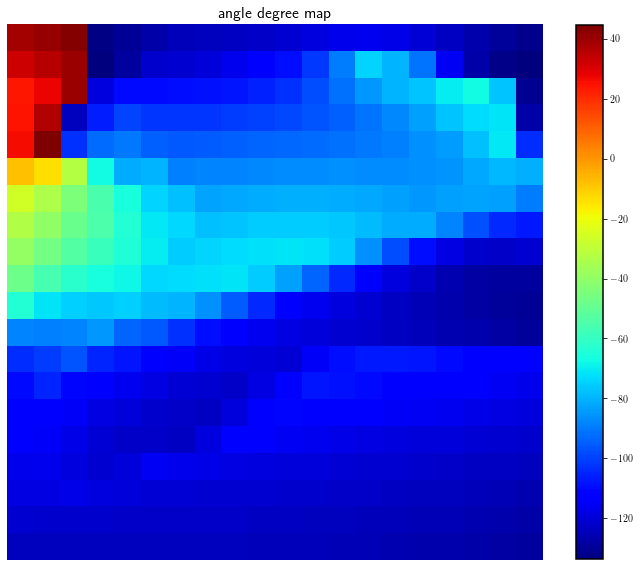

In [108]:
for key, val in maps.items():
    fig, ax = plt.subplots(1, figsize=(12,12))
    ax.set_title("{} map".format(str(key).replace("_", " ")))
    heatmap = ax.imshow(val, cmap='jet')
    plt.colorbar(heatmap, shrink=0.82)
    ax.axis('off')

In [ ]:




"""
  import dataset, and convert to b&w fp32 by summing channels
"""
xbar = misc.face()
xbar = np.sum(xbar.astype(np.float64),axis=2)
dyn = xbar.ptp()
#Plot
plt.figure(0)
plt.title("Original image")
plt.imshow(xbar,interpolation="nearest", cmap=plt.cm.gray)
plt.axis("off")

"""
  Define a 2D, non axis aligned gaussian kernel, and its time reversed version
"""
#define mesh
sizeK = 11 # must be odd
X,Y=np.meshgrid(np.linspace(-1,1,sizeK),np.linspace(-1,1,sizeK))
xvec = np.array([np.reshape(X,X.size),np.reshape(Y,Y.size)])
#define a 2D rotation matrix:
def GetRotMat( theta ):
  return np.array([[np.cos(theta),-np.sin(theta)],
    [np.sin(theta),np.cos(theta)]])
Mrot = GetRotMat( 3.*np.pi/4. )
#define anisotropic and rotated gaussian
Sigma = np.dot(Mrot,np.dot(np.diag([0.15,1]),Mrot.T))
mu = np.array([[0],[0]])
coef = 1/np.sqrt(np.power(2*np.pi,2)*np.linalg.det(Sigma))
#2-dimensional gaussian pdf
test=np.dot(np.linalg.inv(Sigma),xvec-mu)
K=coef * np.exp(-0.5* np.sum(test*(xvec-mu),0))
K=np.reshape(K,X.shape)/K.sum()
#Normalize
K/=K.sum()
KT=K[::-1,::-1]
#Plot
plt.figure(1,figsize=(5,5))
plt.title("2D gaussian kernel")
plt.imshow(K)
plt.axis("off")

"""
  Perform convolution with gaussian kernel + add noise
"""
blurred=scis.convolve2d(xbar, K, mode='same', boundary='symm', fillvalue=0)
stddev = 10
blurred=np.random.poisson(blurred.astype(np.int64)).astype(np.float64)
#blurred += np.random.normal(0,stddev,blurred.shape)
psnrBlurred = measure.compare_psnr(xbar, blurred, dynamic_range=dyn)
ssimBlurred = measure.compare_ssim(xbar, blurred, win_size=5, dynamic_range=dyn)
#Plot
plt.figure(2)
plt.title("Blurred image, PSNR= "+("%.2f" % psnrBlurred)+
  " SSIM= "+("%.2f" % ssimBlurred))
plt.imshow(blurred, interpolation="nearest", cmap=plt.cm.gray)
plt.axis("off")


"""
  Perform Richardson-Lucy algorithm
"""
nbiter = 25
xk=blurred.copy()
for i in range(nbiter):
    estim = scis.convolve2d(xk, K,
      mode='same', boundary='symm', fillvalue=0)
    corr = scis.convolve2d(blurred/estim, KT,
      mode='same', boundary='symm', fillvalue=0)
    xk*=corr

#Evaluate quality
psnrXk = measure.compare_psnr(xk, blurred, dynamic_range=dyn)
ssimXk = measure.compare_ssim(xk, blurred, win_size=5, dynamic_range=dyn)

#Plot
plt.figure(3)
plt.title("Reconstructed image, PSNR= "+("%.2f" % psnrXk)+
  " SSIM= "+("%.2f" % ssimXk))
plt.imshow(xk, interpolation="nearest", cmap=plt.cm.gray)
plt.axis("off")


#Show everything
plt.show()